In [1]:
# Imports
import torch
from torch.utils.data import DataLoader
from datasets.dataset import DINODataset
from models.detector import OVDDetector

/mnt/ddisk/boux/miniconda3/envs/dino_detector/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
from detectron2.config import get_cfg
from detectron2.engine.defaults import DefaultPredictor
from models.crop_rcnn import CropRCNN
from detectron2.config import CfgNode as CN
#from croptrain.engine.trainer import BaselineTrainer
from detectron2.engine import DefaultTrainer
from detectron2.checkpoint import DetectionCheckpointer

def add_croptrainer_config(cfg):
    _C = cfg
    _C.CROPTRAIN = CN()
    _C.CROPTRAIN.USE_CROPS = False
    _C.CROPTRAIN.CLUSTER_THRESHOLD = 0.1
    _C.CROPTRAIN.CROPSIZE = (320, 476, 512, 640)
    _C.CROPTRAIN.MAX_CROPSIZE = 800
    _C.CROPTEST = CN()
    _C.CROPTEST.PREDICT_ONLY = False
    _C.CROPTEST.CLUS_THRESH = 0.3
    _C.CROPTEST.MAX_CLUSTER = 5
    _C.CROPTEST.CROPSIZE = 800
    _C.CROPTEST.DETECTIONS_PER_IMAGE = 800
    _C.MODEL.CUSTOM = CN()
    _C.MODEL.CUSTOM.FOCAL_LOSS_GAMMAS = []
    _C.MODEL.CUSTOM.FOCAL_LOSS_ALPHAS = []

    _C.MODEL.CUSTOM.CLS_WEIGHTS = []
    _C.MODEL.CUSTOM.REG_WEIGHTS = []
     
    # dataloader
    # supervision level
    _C.DATALOADER.SUP_PERCENT = 100.0  # 5 = 5% dataset as labeled set
    _C.DATALOADER.RANDOM_DATA_SEED = 42  # random seed to read data
    _C.DATALOADER.RANDOM_DATA_SEED_PATH = "dataseed/COCO_supervision.txt"

def add_fcos_config(cfg):
    _C = cfg
    _C.MODEL.FCOS = CN()
    _C.MODEL.FCOS.NORM = "GN"
    _C.MODEL.FCOS.NUM_CLASSES = 80
    _C.MODEL.FCOS.NUM_CONVS = 4
    _C.MODEL.FCOS.SCORE_THRESH_TEST = 0.01
    _C.MODEL.FCOS.IN_FEATURES = ["p3", "p4", "p5", "p6", "p7"]

def setup(config_file):
    """
    Create configs and perform basic setups.
    """
    cfg = get_cfg()
    add_croptrainer_config(cfg)
    cfg.merge_from_file(config_file)
    #cfg.merge_from_list(args.opts)
    cfg.freeze()
    #default_setup(cfg, args)
    return cfg

    

In [3]:
config = '/mnt/ddisk/boux/code/DroneDetectron2/configs/Dota-Base-RCNN-FPN.yaml'
ckpt = '/mnt/ddisk/boux/code/DroneDetectron2/outputs_FPN_DOTA/model_final.pth'

Trainer = DefaultTrainer
cfg = setup(config)
model = Trainer.build_model(cfg)
DetectionCheckpointer(model).resume_or_load(ckpt, resume=False)
model.eval()

CropRCNN(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (p7): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2): Sequential(
        (0): BottleneckBlock(
 

In [4]:
from detectron2.structures import ImageList
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
from PIL import Image

def plot_image_with_boxes(image_path, bounding_boxes):
    # Load the image
    img = np.array(Image.open(image_path))

    # Create figure and axes
    fig, ax = plt.subplots(1)

    # Display the image
    ax.imshow(img)

    # Add bounding boxes to the image
    for box in bounding_boxes:
        x1, y1, x2, y2 = box
        width = x2 - x1
        height = y2 - y1
        rect = patches.Rectangle((x1, y1), width, height, linewidth=1, edgecolor='r', facecolor='none')
        ax.add_patch(rect)

    # Show plot
    plt.axis('off')  # Hide axis
    plt.show()

def plot_proposals(img_path, model, threshold=-100):
    im = cv2.imread(img_path)
    batch = torch.tensor(im).permute(2, 0, 1).unsqueeze(0).cuda()
    proposals, _ = generate_proposals(model, batch)
    filt_boxes = proposals[0].proposal_boxes.tensor[proposals[0].objectness_logits > threshold, :]

    # Create subplots
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Plot original image
    axes[0].imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
    axes[0].set_title('Original Image')
    axes[0].axis('off')

    # Plot image with proposals
    im_with_proposals = im.copy()
    for box in filt_boxes.cpu():
        cv2.rectangle(im_with_proposals, (int(box[0]), int(box[1])), (int(box[2]), int(box[3])), (0, 255, 0), 2)
    axes[1].imshow(cv2.cvtColor(im_with_proposals, cv2.COLOR_BGR2RGB))
    axes[1].set_title('Image with Proposals')
    axes[1].axis('off')

    plt.tight_layout()
    plt.show()


def generate_proposals(model, images):
        images = [(x - model.pixel_mean) / model.pixel_std for x in images]
        images = ImageList.from_tensors(
            images,
            model.backbone.size_divisibility,
            padding_constraints=model.backbone.padding_constraints,
        )
        features = model.backbone(images.tensor)
        proposals = model.proposal_generator(images, features, None)
        
        return proposals

/mnt/ddisk/boux/miniconda3/envs/dino_detector/lib/python3.9/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3190.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


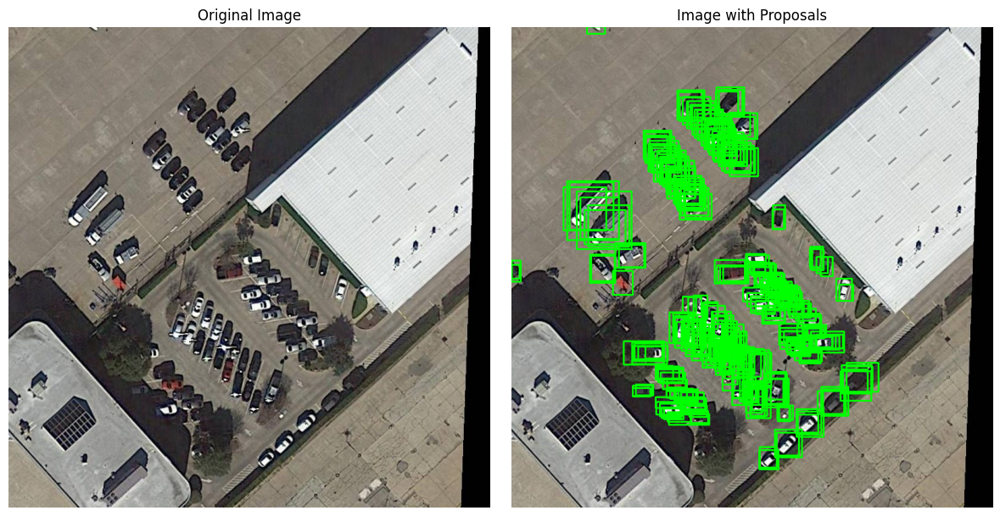

In [5]:
import cv2
img_path = '/mnt/ddisk/boux/code/data/dota2.0/preprocessed/ovd_experiment/val/images/P1512__1.0__916___600.jpg'
plot_proposals(img_path, model, threshold = 0)

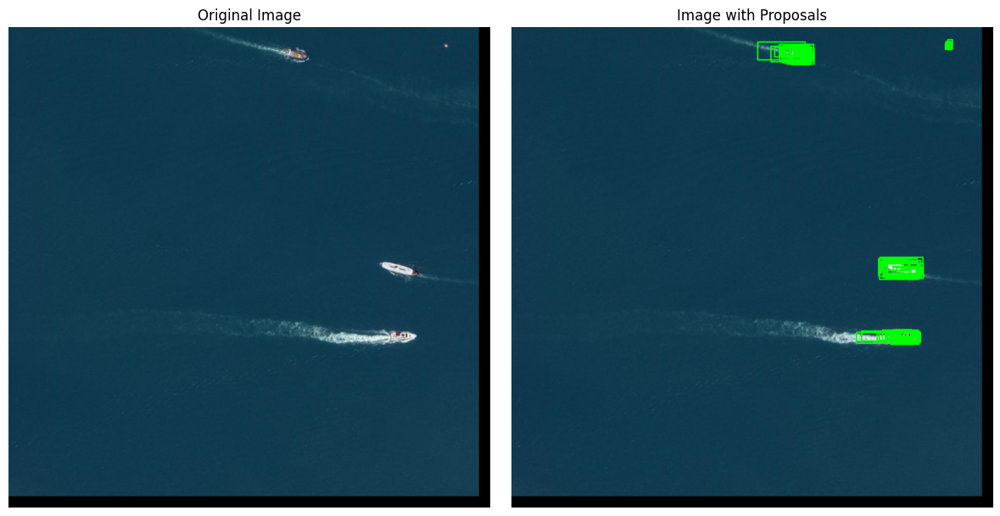

In [6]:
img_path = '/mnt/ddisk/boux/code/data/fair1m/val/preprocessed/images/3__1__0___0.jpg'
plot_proposals(img_path, model, threshold = 0)

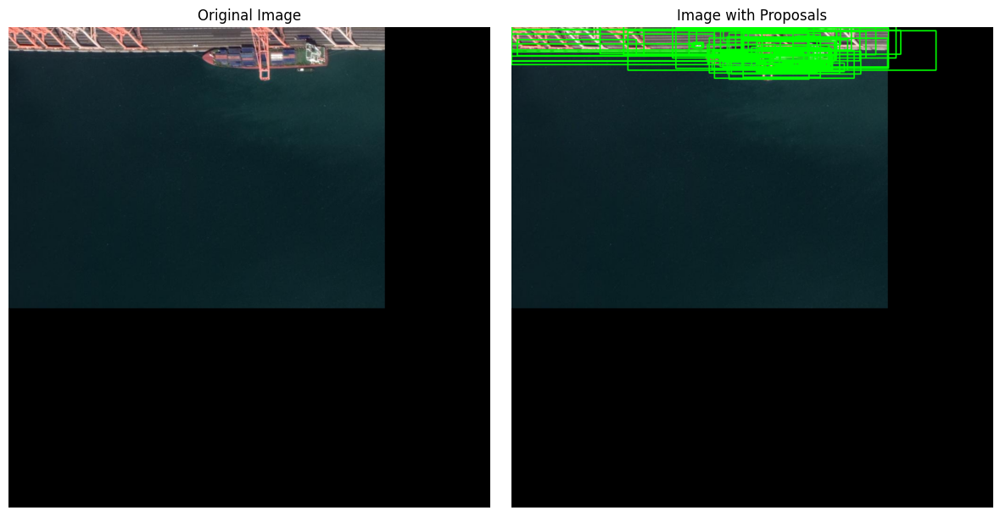

In [7]:
img_path = '/mnt/ddisk/boux/code/data/fair1m/val/preprocessed/images/8__1__0___0.jpg'
plot_proposals(img_path, model, threshold = 0)

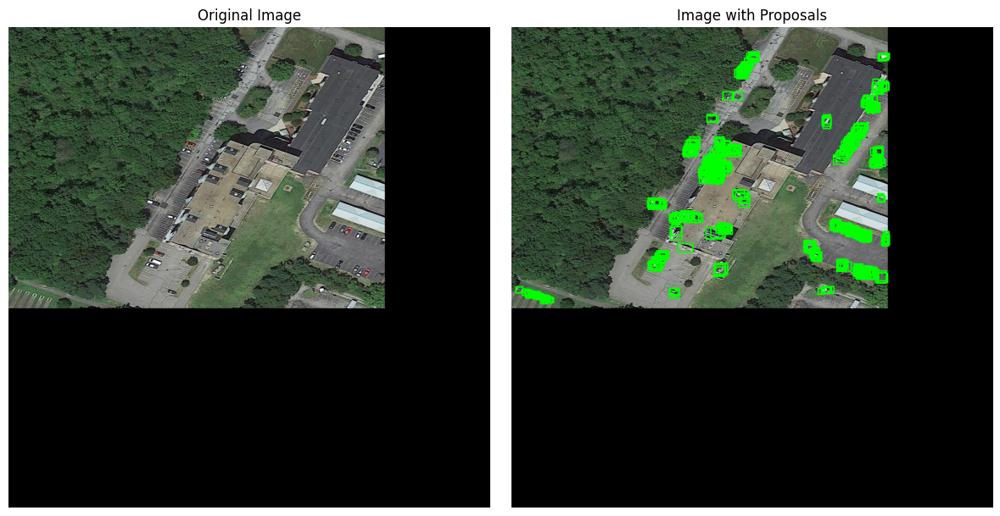

In [8]:
img_path = '/mnt/ddisk/boux/code/data/fair1m/val/preprocessed/images/17__1__0___0.jpg'
plot_proposals(img_path, model, threshold = 0)

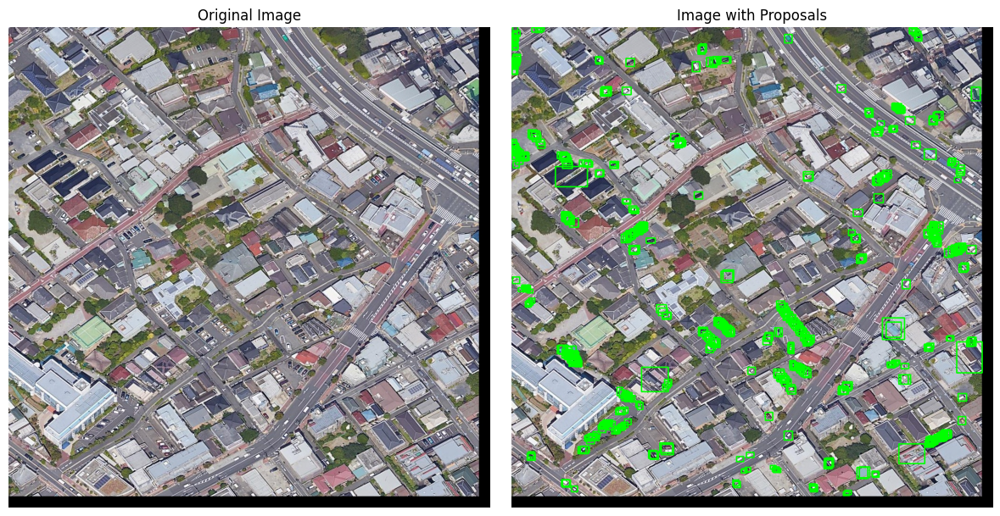

In [9]:
img_path = '/mnt/ddisk/boux/code/data/fair1m/val/preprocessed/images/53__1__0___0.jpg'
plot_proposals(img_path, model, threshold = 0)

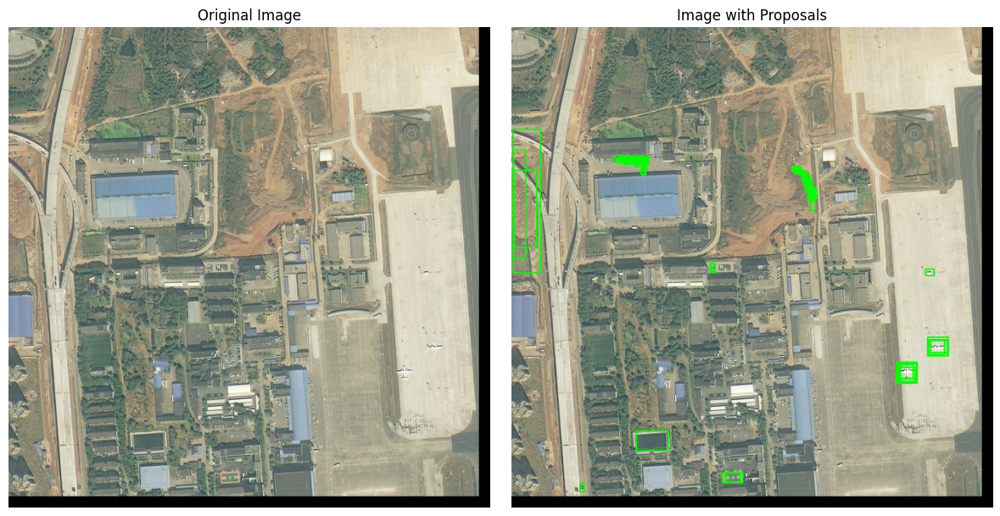

In [10]:
img_path = '/mnt/ddisk/boux/code/data/fair1m/val/preprocessed/images/65__1__0___0.jpg'
plot_proposals(img_path, model, threshold = 0)

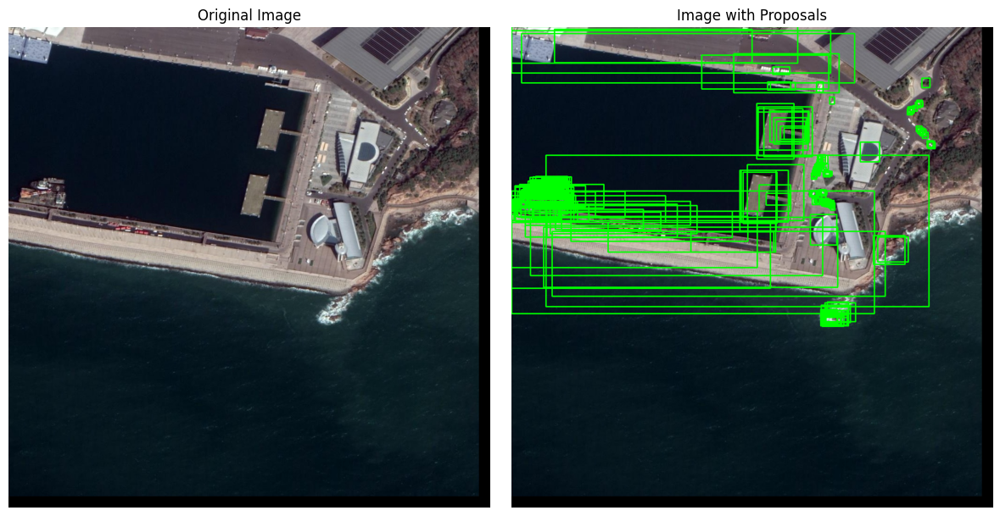

In [11]:
img_path = '/mnt/ddisk/boux/code/data/fair1m/val/preprocessed/images/256__1__0___0.jpg'
plot_proposals(img_path, model, threshold = 0)

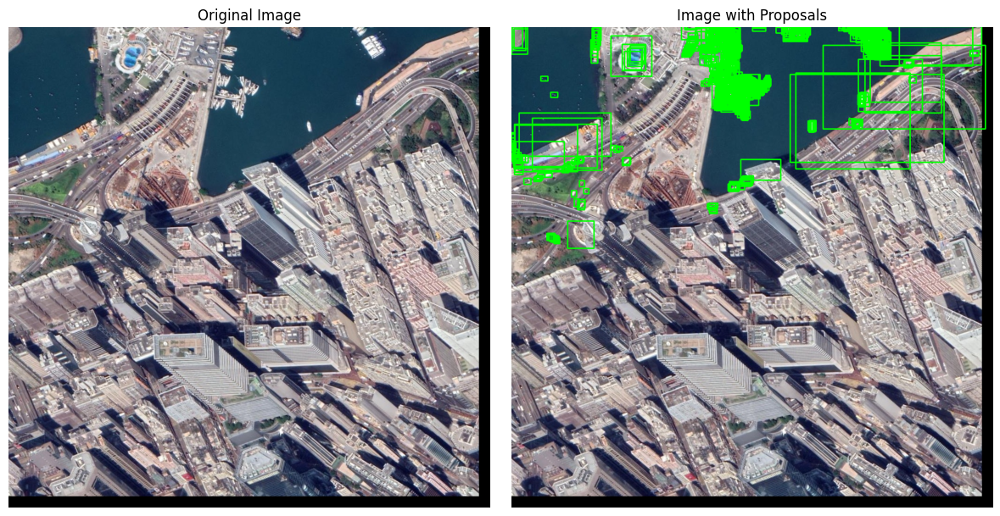

In [12]:
img_path = '/mnt/ddisk/boux/code/data/fair1m/val/preprocessed/images/268__1__0___0.jpg'
plot_proposals(img_path, model, threshold = 0)

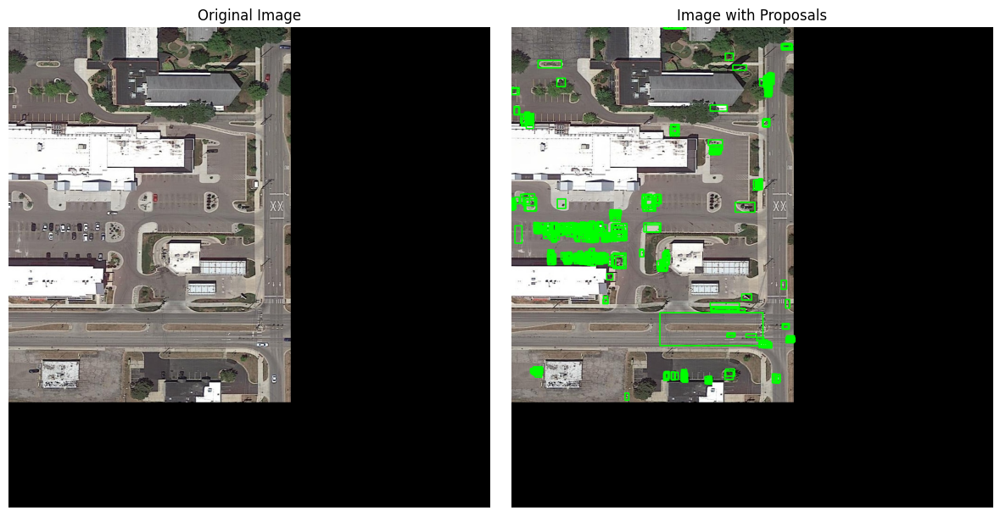

In [13]:
img_path = '/mnt/ddisk/boux/code/data/fair1m/val/preprocessed/images/280__1__0___0.jpg'
plot_proposals(img_path, model, threshold = 0)

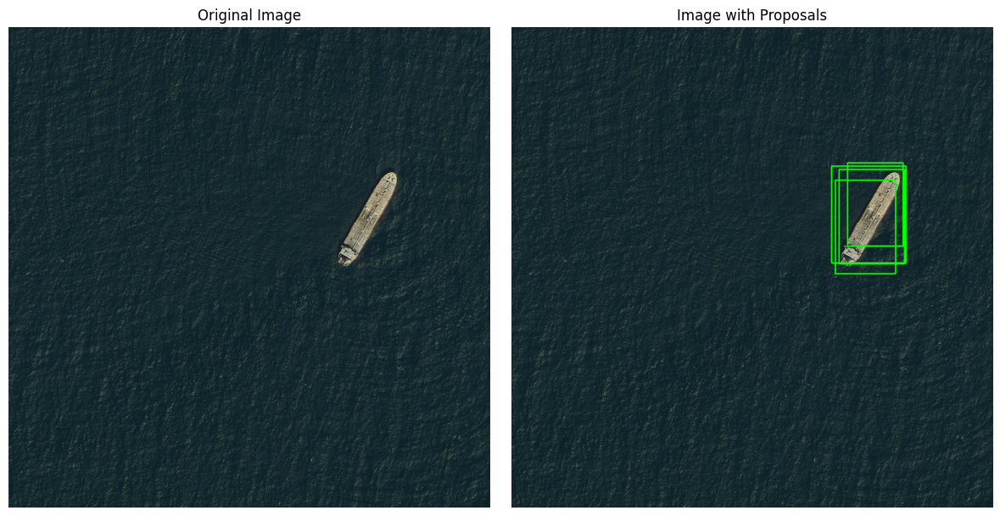

In [14]:
img_path = '/mnt/ddisk/boux/code/data/fair1m/val/preprocessed/images/285__1__924___3696.jpg'
plot_proposals(img_path, model, threshold = 0)

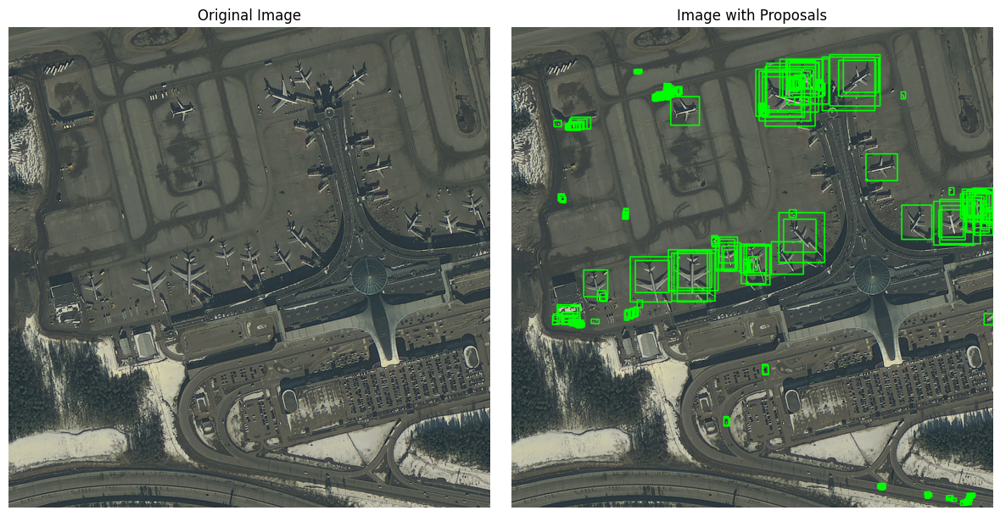

In [15]:
img_path = '/mnt/ddisk/boux/code/data/fair1m/val/preprocessed/images/290__1__0___2331.jpg'
plot_proposals(img_path, model, threshold = 0)

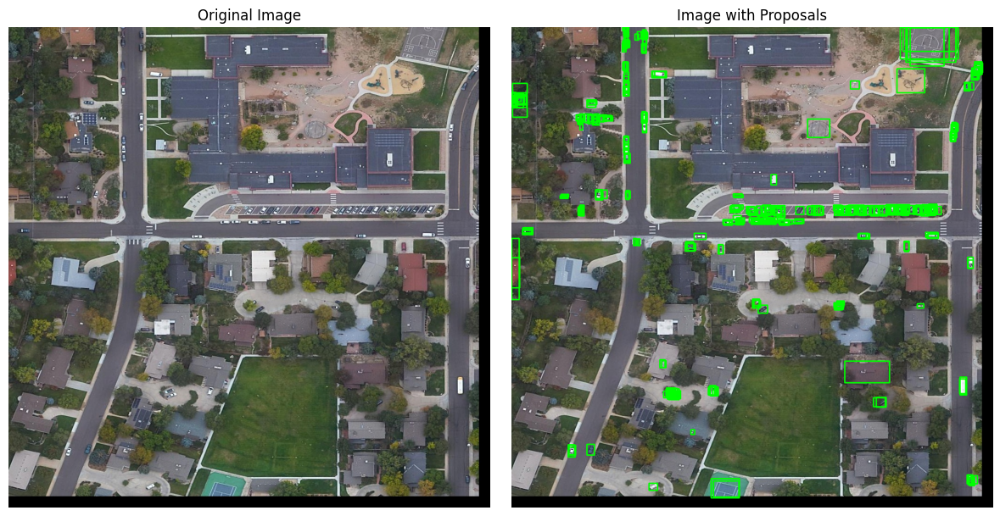

In [16]:
img_path = '/mnt/ddisk/boux/code/data/fair1m/val/preprocessed/images/305__1__0___0.jpg'
plot_proposals(img_path, model, threshold = 0)

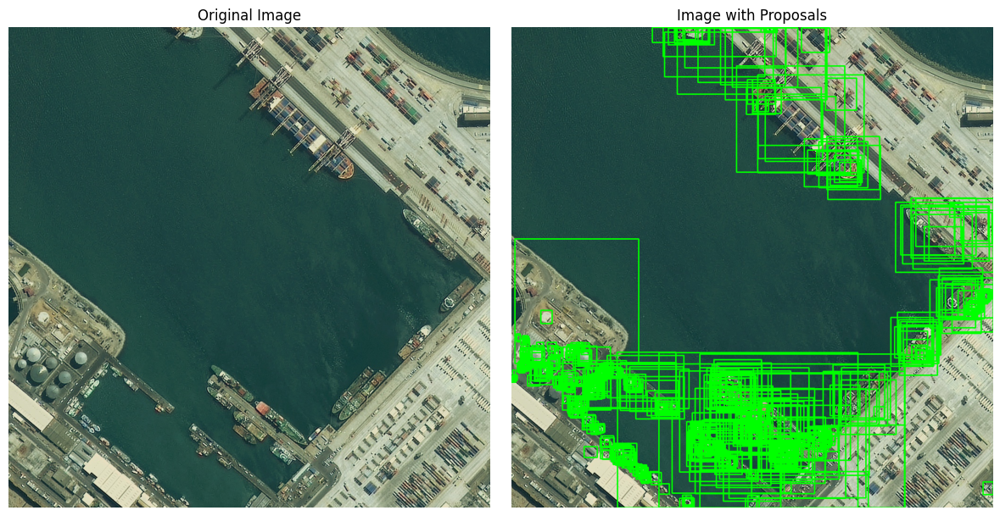

In [17]:
img_path = '/mnt/ddisk/boux/code/data/fair1m/val/preprocessed/images/319__1__2976___2772.jpg'
plot_proposals(img_path, model, threshold = 0)

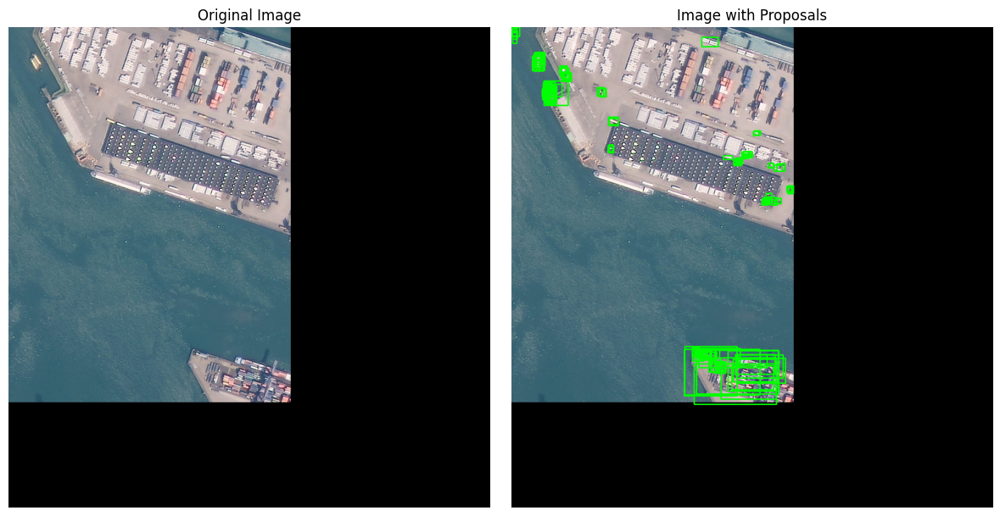

In [18]:
img_path = '/mnt/ddisk/boux/code/data/fair1m/val/preprocessed/images/361__1__0___0.jpg'
plot_proposals(img_path, model, threshold = 0)

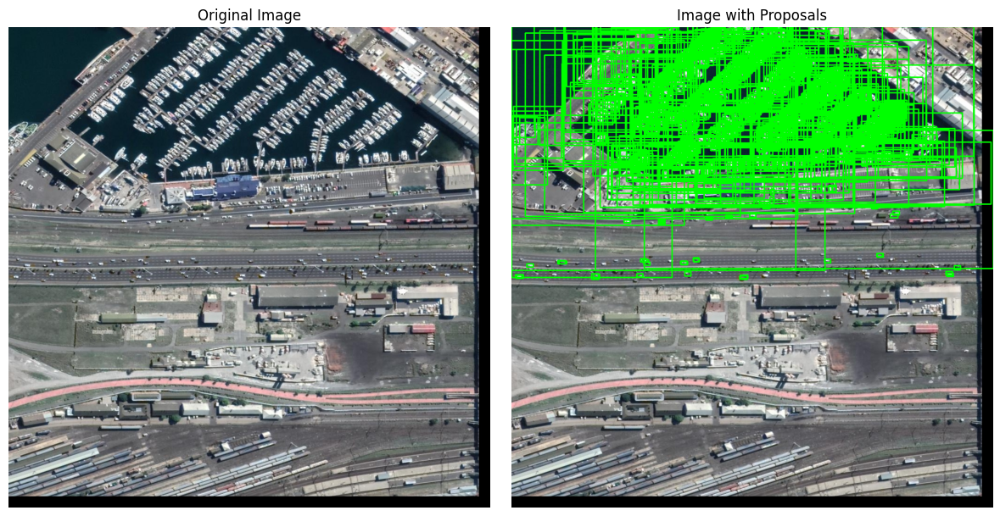

In [19]:
img_path = '/mnt/ddisk/boux/code/data/fair1m/val/preprocessed/images/393__1__0___0.jpg'
plot_proposals(img_path, model, threshold = 0)

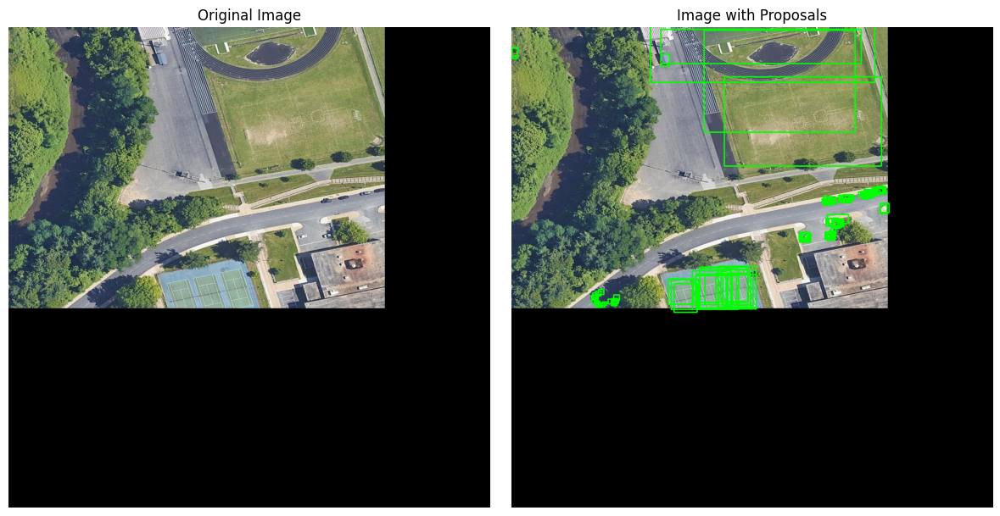

In [20]:
img_path = '/mnt/ddisk/boux/code/data/fair1m/val/preprocessed/images/438__1__0___0.jpg'
plot_proposals(img_path, model, threshold = 0)

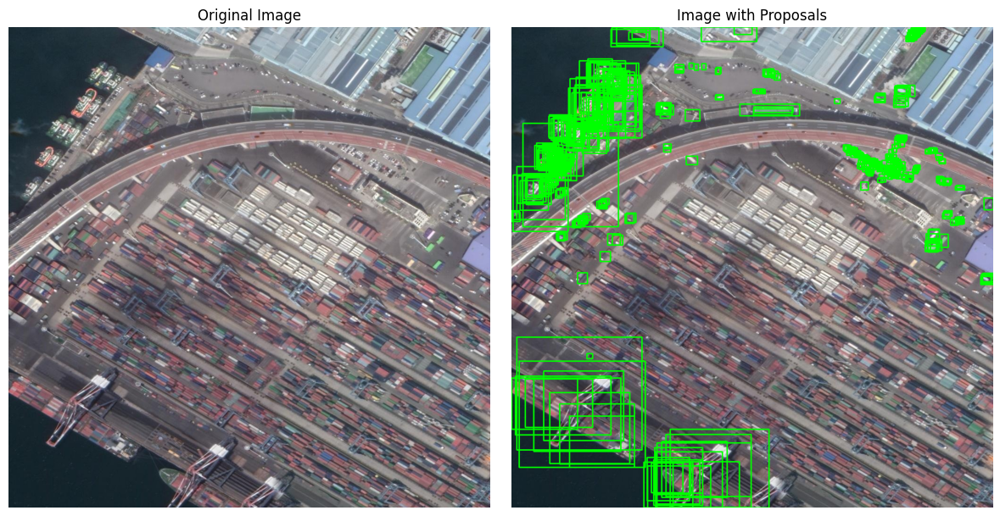

In [21]:
img_path = '/mnt/ddisk/boux/code/data/fair1m/val/preprocessed/images/537__1__0___0.jpg'
plot_proposals(img_path, model, threshold = 0)

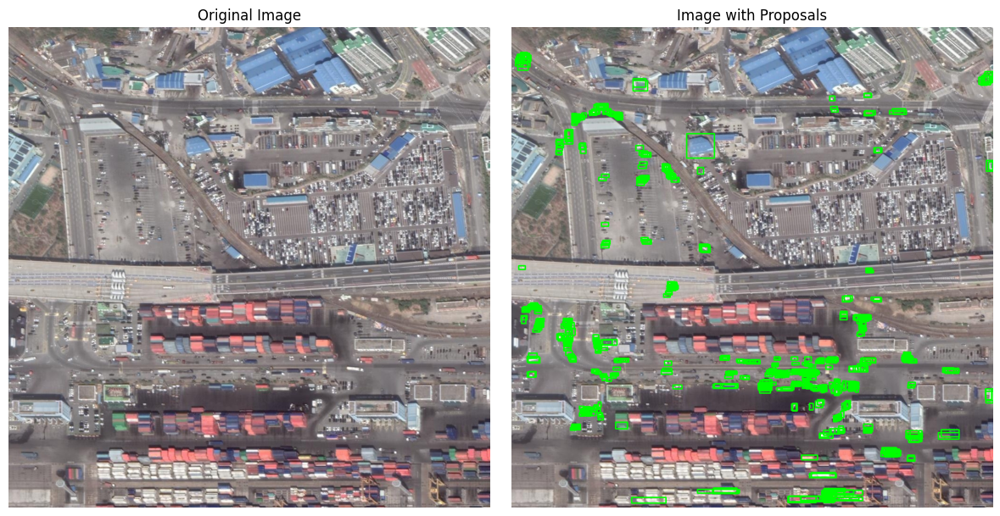

In [22]:
img_path = '/mnt/ddisk/boux/code/data/fair1m/val/preprocessed/images/537__1__1848___0.jpg'
plot_proposals(img_path, model, threshold = 0)

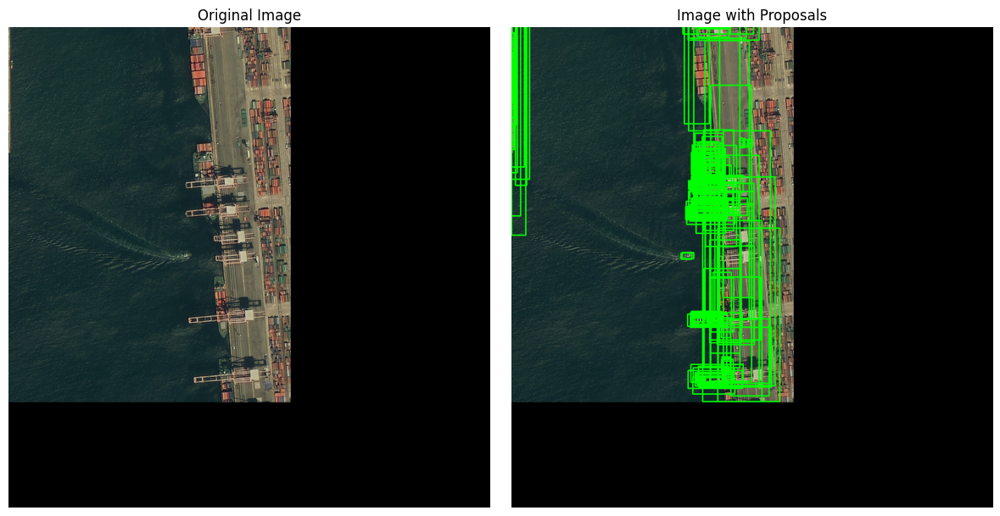

In [23]:
img_path = '/mnt/ddisk/boux/code/data/fair1m/val/preprocessed/images/776__1__0___0.jpg'
plot_proposals(img_path, model, threshold = 0)

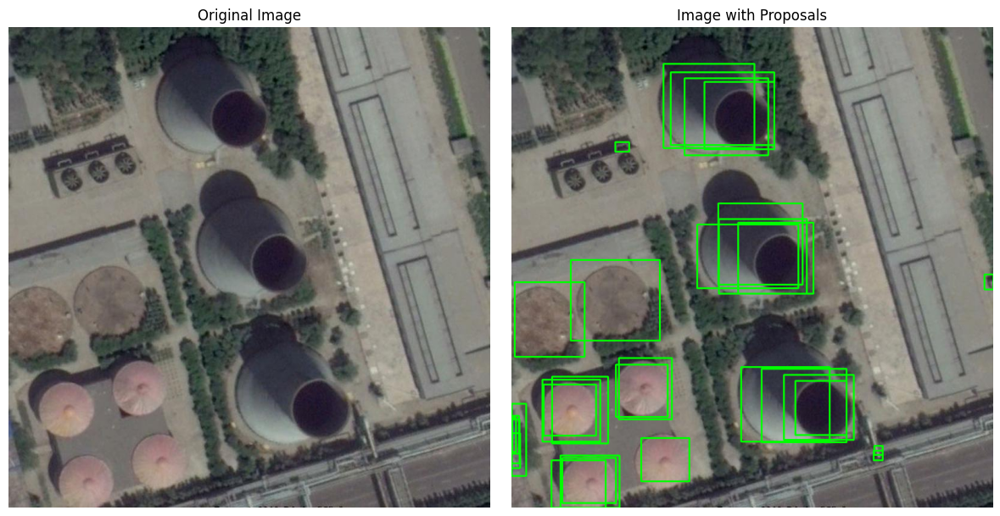

In [24]:
img_path = '/mnt/ddisk/boux/code/data/dior/DIOR/11757.jpg'
plot_proposals(img_path, model, threshold = 0)

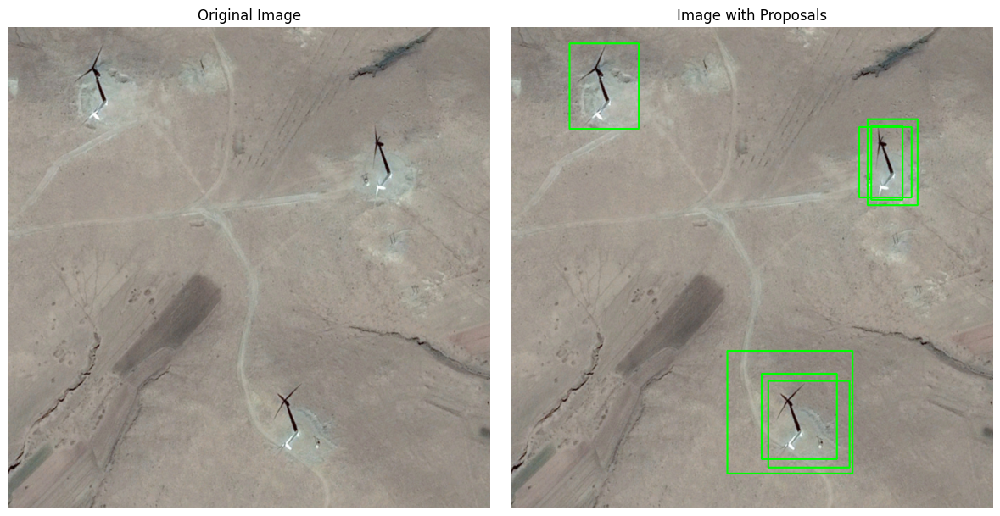

In [25]:
img_path = '/mnt/ddisk/boux/code/data/dior/DIOR/11758.jpg'
plot_proposals(img_path, model, threshold = 0)

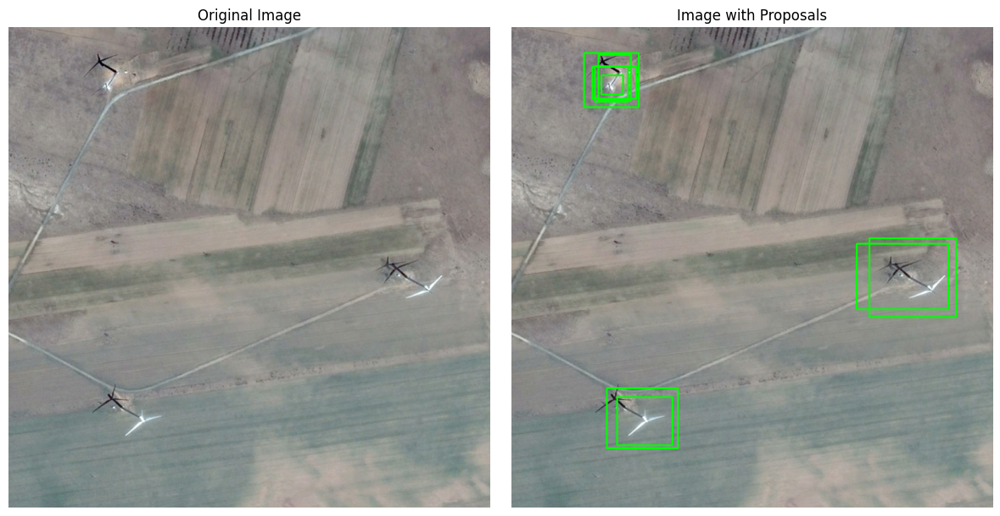

In [26]:
img_path = '/mnt/ddisk/boux/code/data/dior/DIOR/11759.jpg'
plot_proposals(img_path, model, threshold = 0)

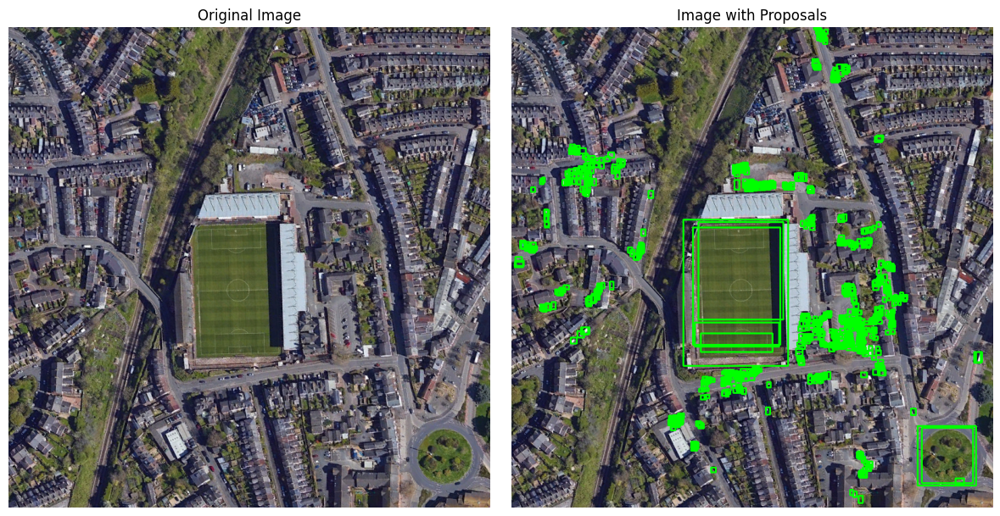

In [27]:
img_path = '/mnt/ddisk/boux/code/data/dior/DIOR/11784.jpg'
plot_proposals(img_path, model, threshold = 0)

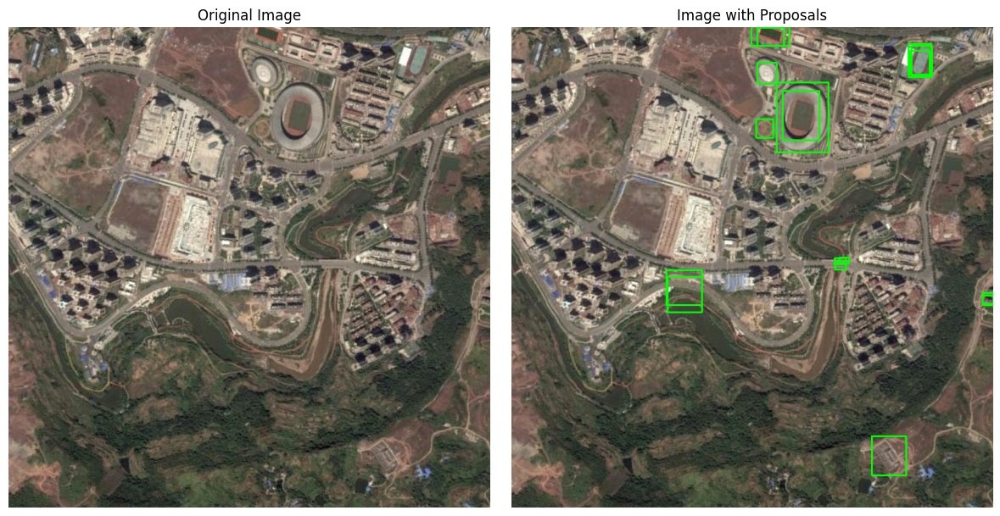

In [28]:
img_path = '/mnt/ddisk/boux/code/data/dior/DIOR/11786.jpg'
plot_proposals(img_path, model, threshold = 0)

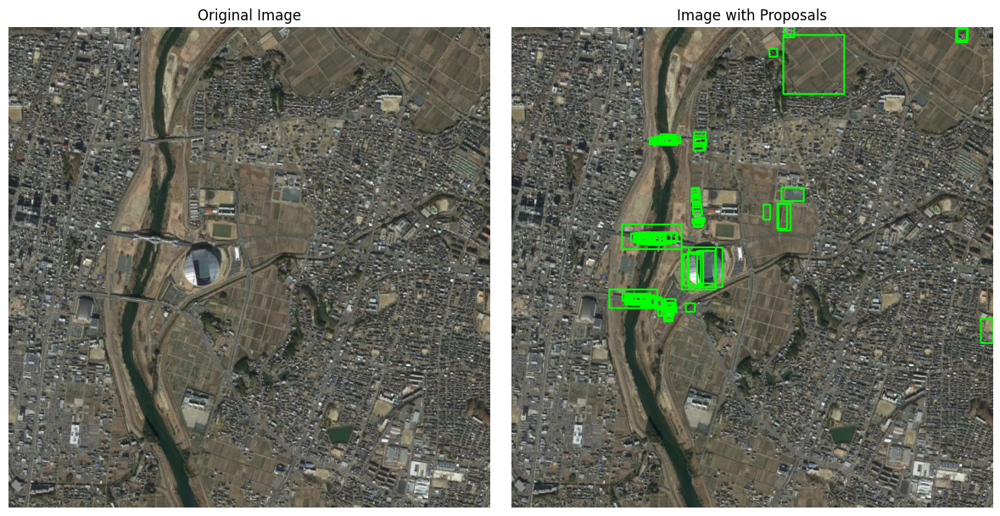

In [29]:
img_path = '/mnt/ddisk/boux/code/data/dior/DIOR/11795.jpg'
plot_proposals(img_path, model, threshold = 0)

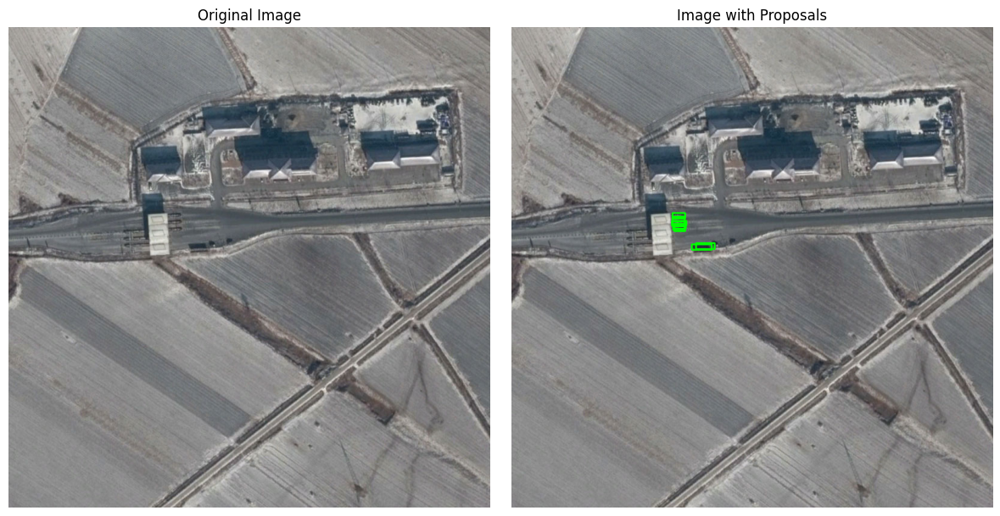

In [30]:
img_path = '/mnt/ddisk/boux/code/data/dior/DIOR/11798.jpg'
plot_proposals(img_path, model, threshold = 0)

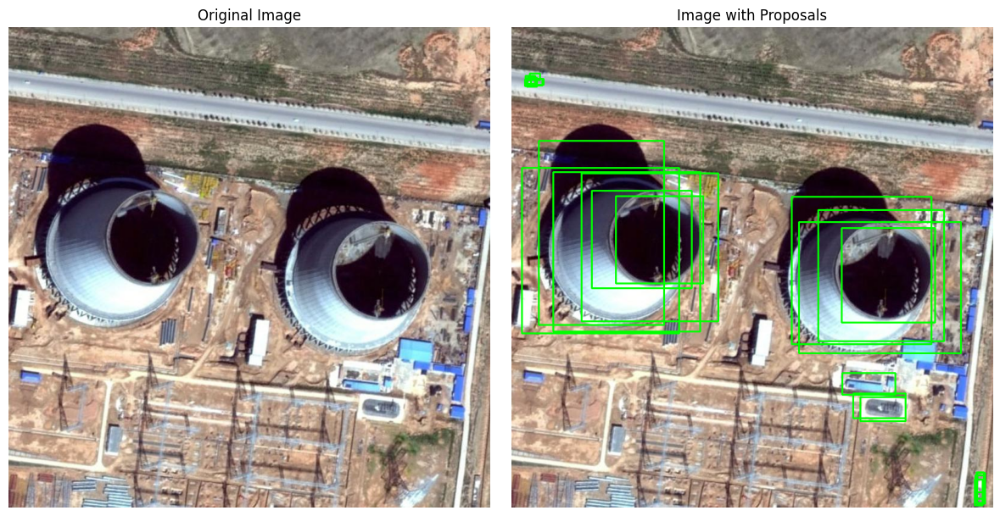

In [31]:
img_path = '/mnt/ddisk/boux/code/data/dior/DIOR/11810.jpg'
plot_proposals(img_path, model, threshold = 0)

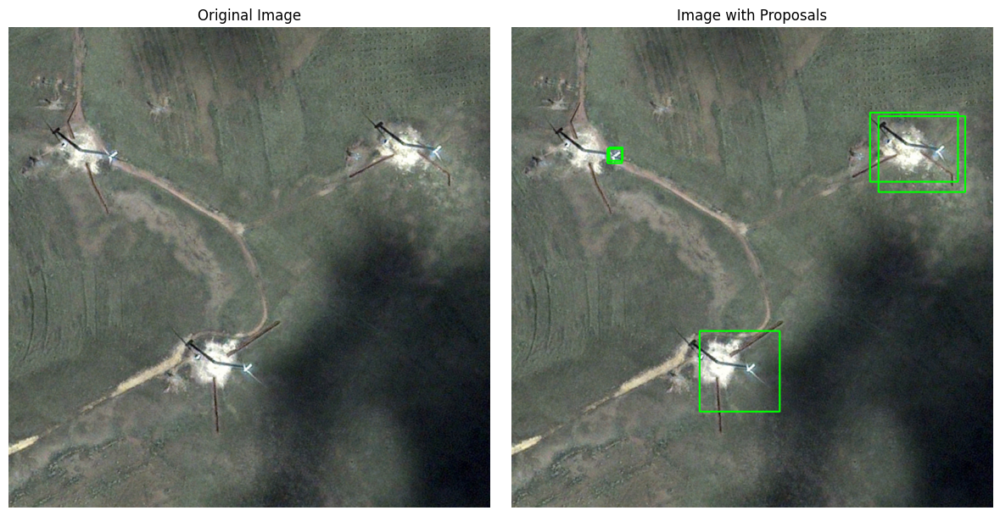

In [32]:
img_path = '/mnt/ddisk/boux/code/data/dior/DIOR/11812.jpg'
plot_proposals(img_path, model, threshold = 0)

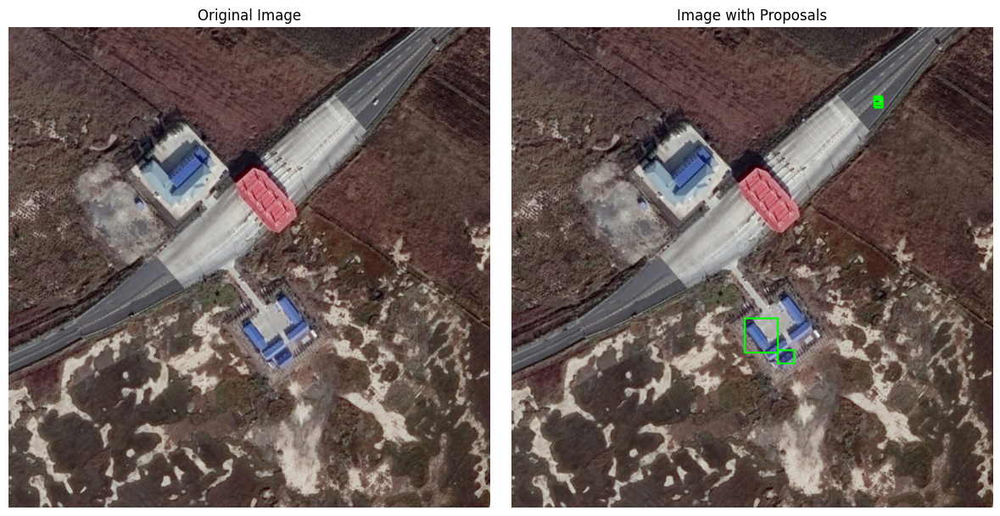

In [33]:
img_path = '/mnt/ddisk/boux/code/data/dior/DIOR/11815.jpg'
plot_proposals(img_path, model, threshold = 0)

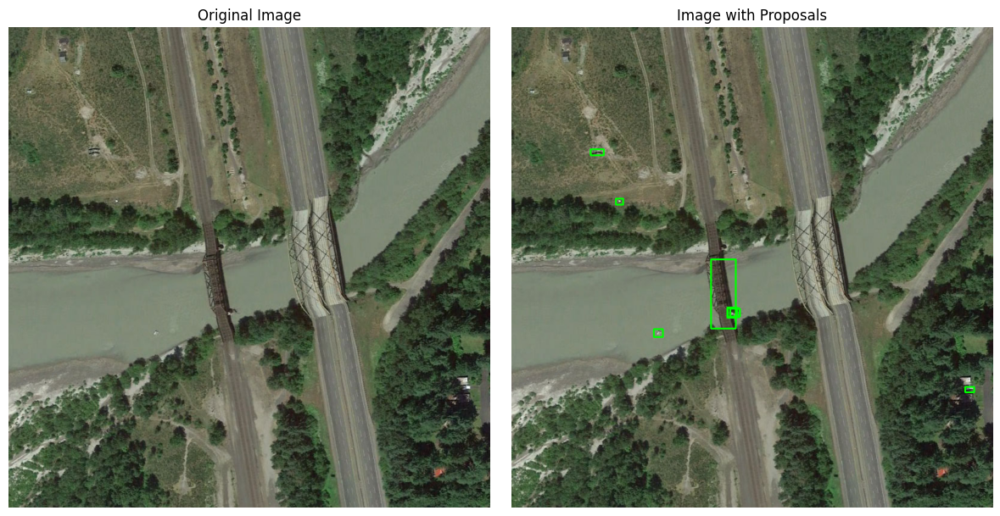

In [34]:
img_path = '/mnt/ddisk/boux/code/data/dior/DIOR/11845.jpg'
plot_proposals(img_path, model, threshold = 0)

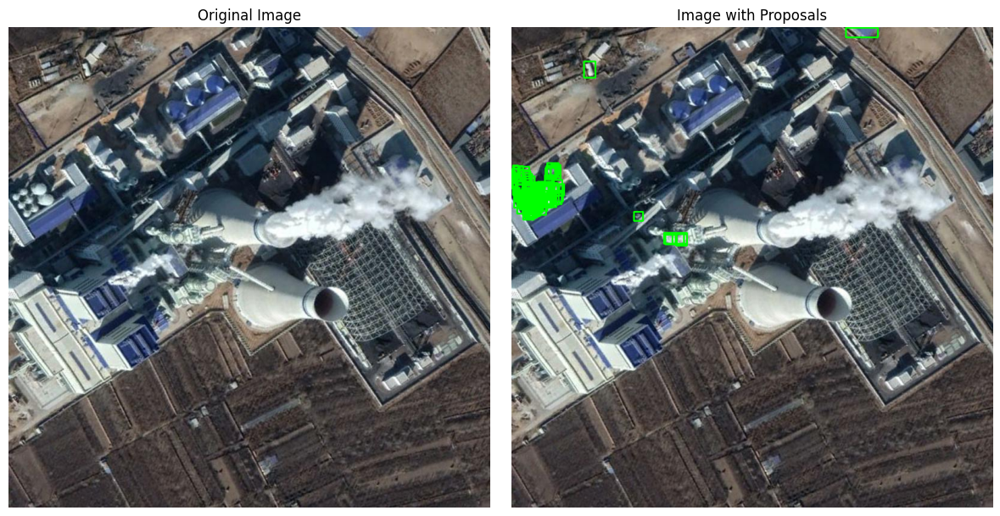

In [35]:
img_path = '/mnt/ddisk/boux/code/data/dior/DIOR/11866.jpg'
plot_proposals(img_path, model, threshold = 0)

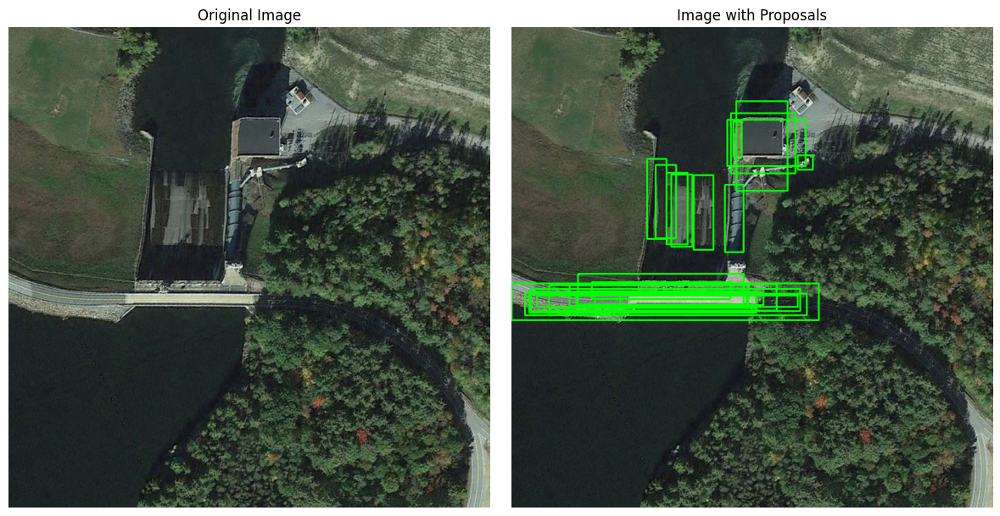

In [36]:
img_path = '/mnt/ddisk/boux/code/data/dior/DIOR/11877.jpg'
plot_proposals(img_path, model, threshold = 0)

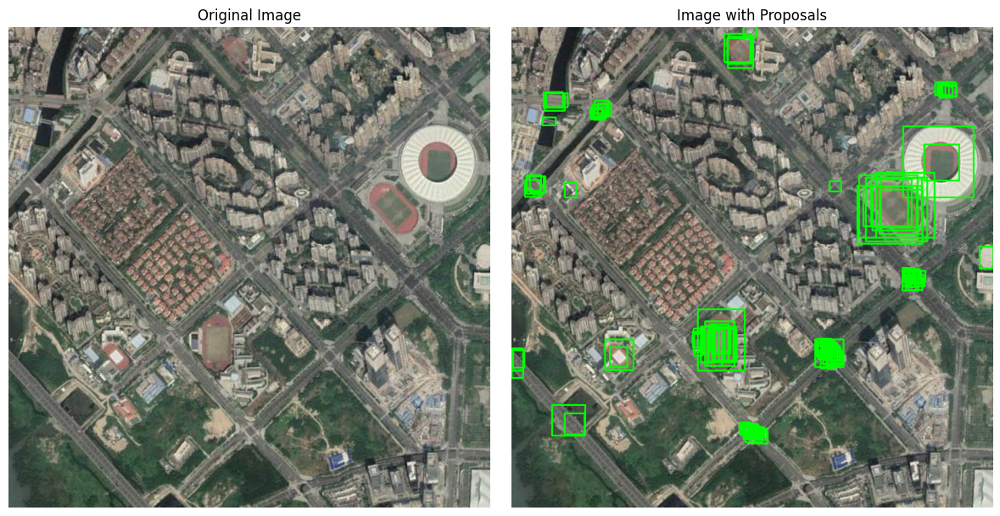

In [37]:
img_path = '/mnt/ddisk/boux/code/data/dior/DIOR/11900.jpg'
plot_proposals(img_path, model, threshold = 0)

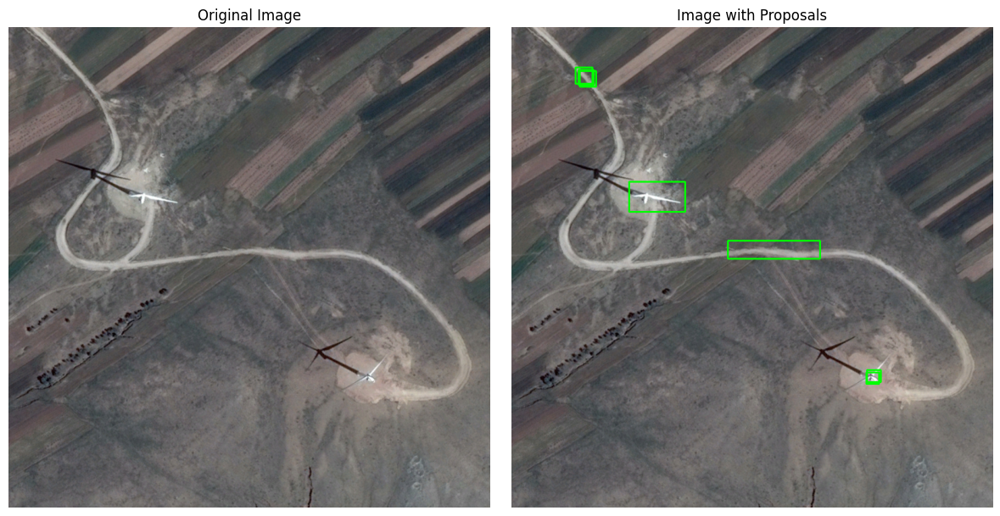

In [38]:
img_path = '/mnt/ddisk/boux/code/data/dior/DIOR/11929.jpg'
plot_proposals(img_path, model, threshold = 0)

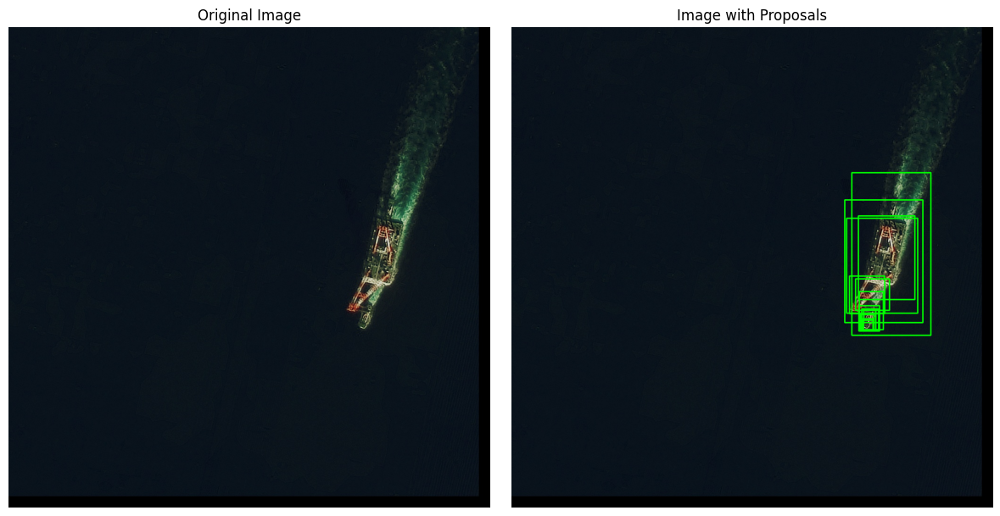

In [39]:
img_path = '/mnt/ddisk/boux/code/data/fair1m/train/preprocessed/yolo/test_10-40/images/2701__1__0___0.jpg'
plot_proposals(img_path, model, threshold = 0)

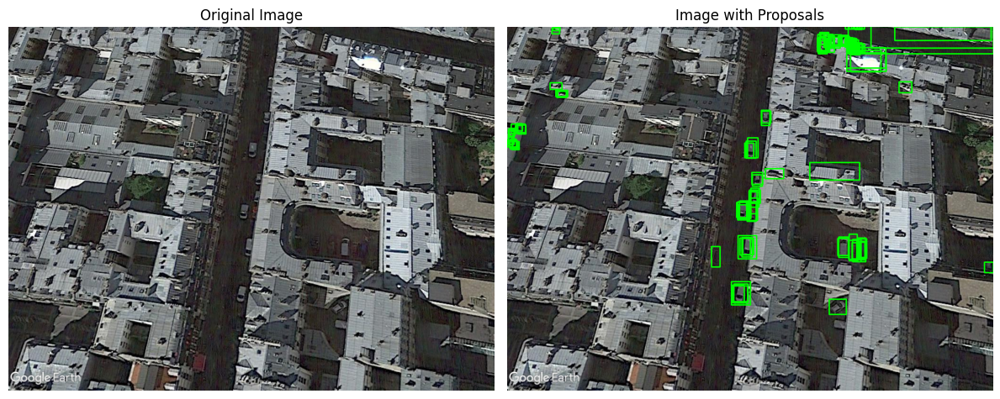

In [41]:
img_path = '/mnt/ddisk/boux/code/data/simd/training/0010.jpg'
plot_proposals(img_path, model, threshold = 0)

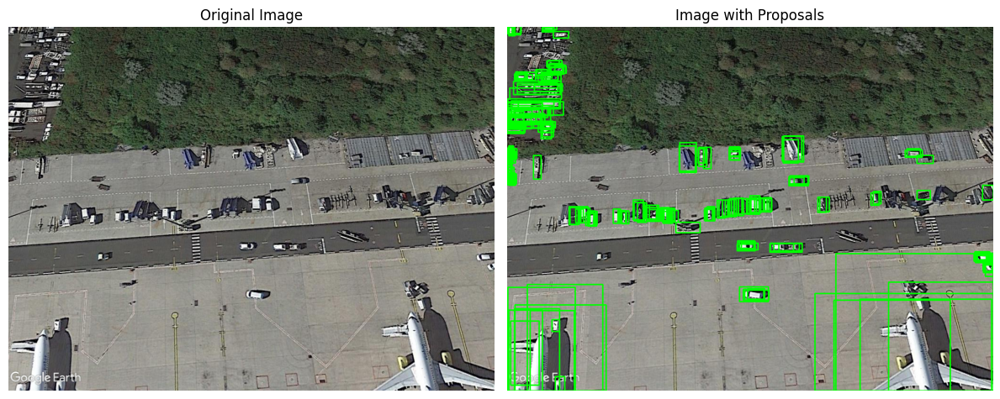

In [42]:
img_path = '/mnt/ddisk/boux/code/data/simd/training/0018.jpg'
plot_proposals(img_path, model, threshold = 0)

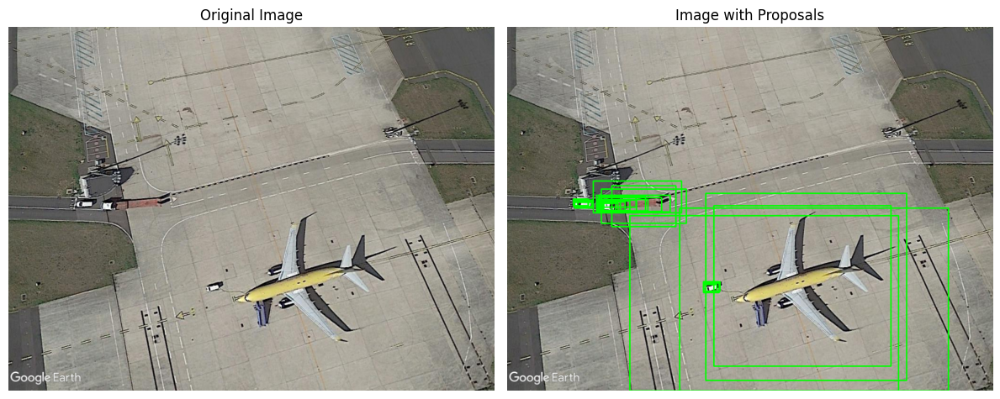

In [43]:
img_path = '/mnt/ddisk/boux/code/data/simd/training/0019.jpg'
plot_proposals(img_path, model, threshold = 0)

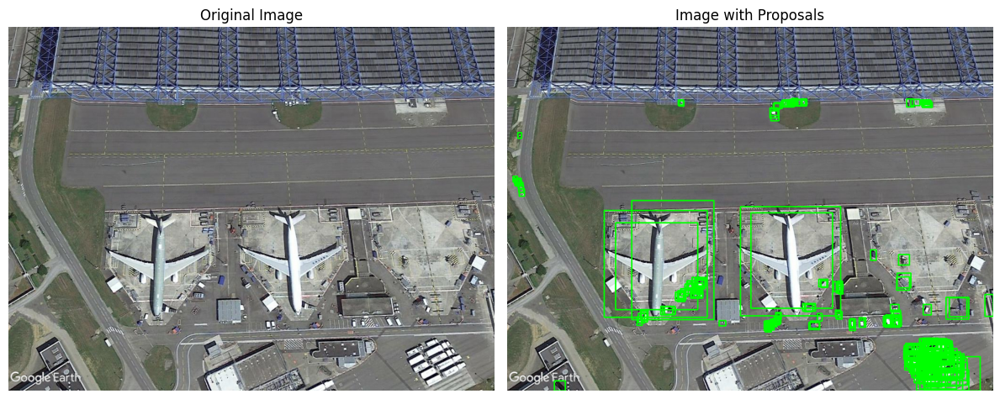

In [44]:
img_path = '/mnt/ddisk/boux/code/data/simd/training/0021.jpg'
plot_proposals(img_path, model, threshold = 0)

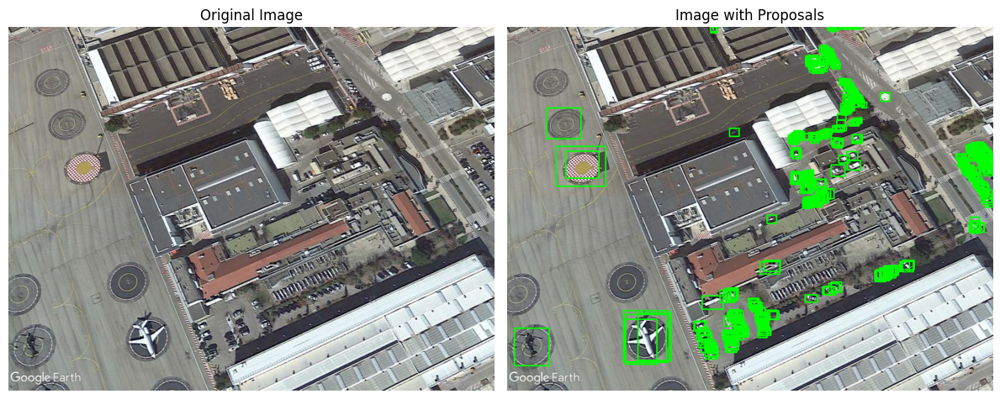

In [45]:
img_path = '/mnt/ddisk/boux/code/data/simd/training/0057.jpg'
plot_proposals(img_path, model, threshold = 0)

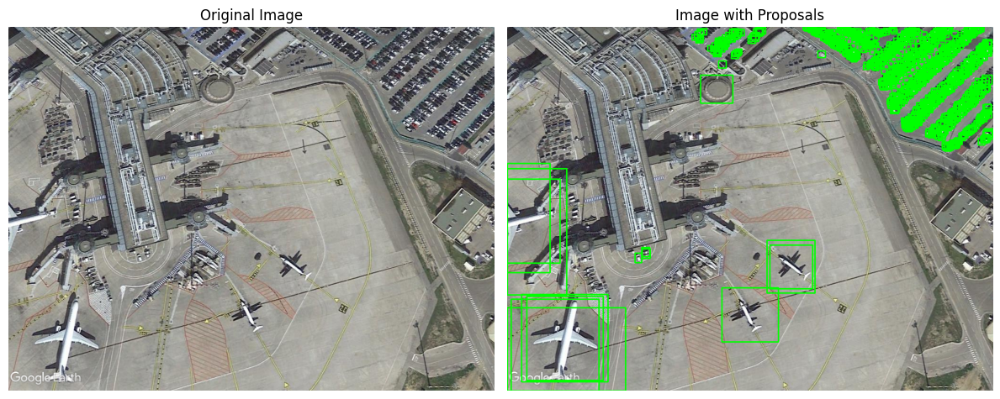

In [46]:
img_path = '/mnt/ddisk/boux/code/data/simd/training/0058.jpg'
plot_proposals(img_path, model, threshold = 0)

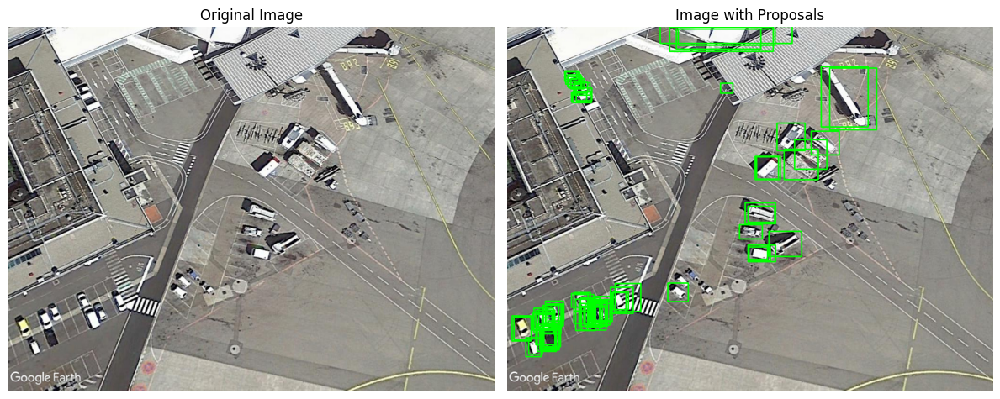

In [47]:
img_path = '/mnt/ddisk/boux/code/data/simd/training/0098.jpg'
plot_proposals(img_path, model, threshold = 0)

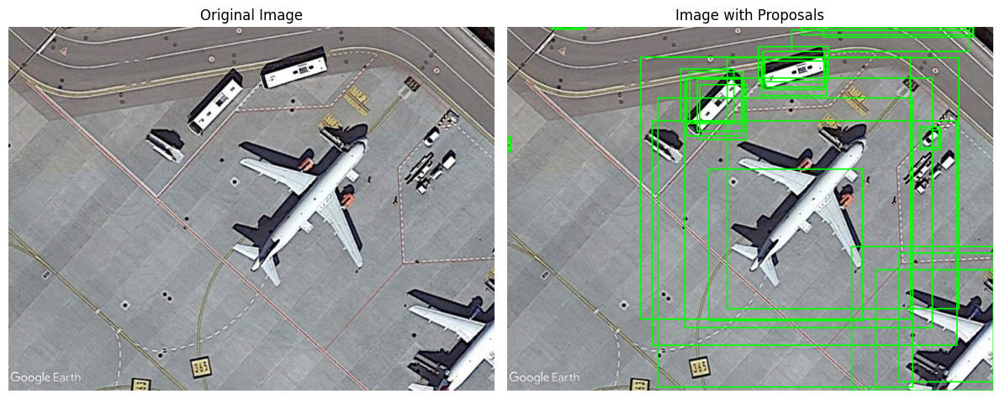

In [48]:
img_path = '/mnt/ddisk/boux/code/data/simd/training/1076.jpg'
plot_proposals(img_path, model, threshold = 0)

In [ ]:
img_path = ''
plot_proposals(img_path, model, threshold = 0)

In [ ]:
img_path = ''
plot_proposals(img_path, model, threshold = 0)

In [ ]:
img_path = ''
plot_proposals(img_path, model, threshold = 0)

In [ ]:
img_path = ''
plot_proposals(img_path, model, threshold = 0)

In [ ]:
img_path = ''
plot_proposals(img_path, model, threshold = 0)

In [ ]:
img_path = ''
plot_proposals(img_path, model, threshold = 0)

In [ ]:
img_path = ''
plot_proposals(img_path, model, threshold = 0)